# Explore the dataset

In this notebook, we will perform an EDA (Exploratory Data Analysis) on the processed Waymo dataset (data in the `processed` folder).

In [1]:
# Import libraries
import logging
from os import listdir
import random

import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import numpy as np
import pandas as pd
from PIL import ImageStat
from tabulate import tabulate
import tensorflow as tf

from utils import get_module_logger
from utils import get_dataset
%matplotlib inline

In [2]:
# Set up logger
logging.basicConfig(filename = 'errors.log', level = logging.WARNING)
logger = get_module_logger(__name__)

# Limit messages from tensorflow
tf.compat.v1.logging.set_verbosity(40)

## Write a function to display an image and the bounding boxes

Implement the `display_instances` function below. This function takes a batch as an input and displays an image with its corresponding bounding boxes. The only requirement is that the classes should be color coded (eg, vehicles in red, pedestrians in blue, cyclist in green).

In [4]:
def display_instances(batch, row, col, ax):
    """
    This function takes a batch from the dataset and displays the image with 
    the associated bounding boxes.
    """  

    # Cast image from batch to float32, plot image on ax[row, col]   
    image = tf.cast(batch['image']/255, tf.float32)  
    ax[row, col].imshow(image)
    ax[row, col].axis('off')
        
    # Load bounding boxes and corresponding classes
    bboxes = batch['groundtruth_boxes'].numpy()
    classes = batch['groundtruth_classes'].numpy()
    
    # Add bounding boxes to ax[row, col], vehicles in red [1,0,0], 
    # pedestrians in blue [0,1,0], cyclists in green [0,0,1]
    colormap = {1: [1,0,0], 2: [0,0,1], 4:[0,1,0]}
    for box, cls in zip(bboxes, classes):
        y1, x1, y2, x2 = box
        y1 = y1 * 640
        x1 = x1 * 640
        y2 = y2 * 640
        x2 = x2 * 640
        rec = Rectangle((x1, y1), x2 - x1, y2 - y1, 
                         facecolor = 'none', edgecolor = colormap[cls])
        ax[row, col].add_patch(rec)                  

In [5]:
# Generate list of tensorflow records, select a random file, generate dataset
files = listdir("data/train")
file = random.choice(files)
dataset = get_dataset("data/train/" + file)

## Display 1 image from each tensorflow record

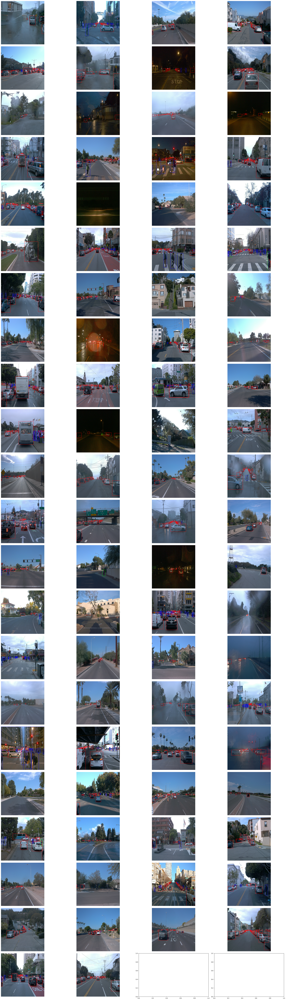

In [6]:
# Set number of figure columns and calculate number of rows
columns = 4
rows = int(np.ceil(len(files) / columns))
fig, ax = plt.subplots(rows, columns, figsize = (30, 100))

# Iterate over all files
row = -1
for nr, file in enumerate(files):
    dataset = get_dataset("data/train/" + file)
    for idx, batch in enumerate(dataset.take(1)):
        if idx == 0:
            column = nr % columns
            if column == 0:
                row = row + 1
            display_instances(batch, row, column, ax)
fig.tight_layout()

## Display 10 images from 1 tensorflow record

Using the dataset created in the second cell and the function you just coded, display 10 random images with the associated bounding boxes. You can use the methods `take` and `shuffle` on the dataset.

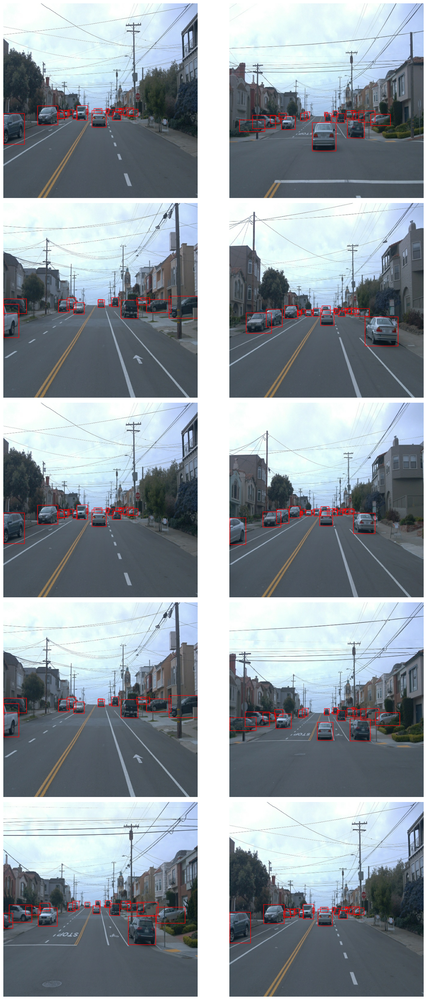

In [7]:
# Set number of images to display
total = 10

# Shuffle dataset
dataset = dataset.shuffle(buffer_size=total)

# Size and initialize figure
columns = 2
rows = int(np.ceil(total / columns))
fig, ax = plt.subplots(rows, columns, figsize=(15, 30))

# Populate figure
row = -1
for nr in range(total):
    for _idx, batch in enumerate(dataset.take(1)):
        column = nr % columns
        if column == 0:
            row = row + 1
        display_instances(batch, row, column, ax)
fig.tight_layout()

## Additional EDA

In this last part, you are free to perform any additional analysis of the dataset. What else would like to know about the data?
For example, think about data distribution. So far, you have only looked at a single file ...

### Analyze classes and bounding boxes

In [92]:
tfFile = []
numBboxes = []
numVehicles = []
numPedestrians = []
numCyclists = []
boxFile = []
boxImage = []
boxClass = []
boxCoor = []
boxArea = []
boxCenterQuadrant = []

# Iterate over tensorflow files
for idx, file in enumerate(files):
    if idx < len(files):
        # Select file
        dataset = get_dataset('data/train/' + file)
        # Generate buffer
        # dataset = dataset.shuffle(buffer_size=100)
        for idj, batch in enumerate(dataset.take(100)):
            # Count number of bounding boxes and dynamic agent types
            bboxes = batch['groundtruth_boxes'].numpy()
            classes = batch['groundtruth_classes'].numpy()
            tfFile.append(file[:-28])
            numBboxes.append(len(bboxes))
            numVehicles.append(np.count_nonzero(classes == 1))
            numPedestrians.append(np.count_nonzero(classes == 2))
            numCyclists.append(np.count_nonzero(classes == 4))
            # Calculate information specific to each bounding box
            for box, cls in zip(bboxes, classes):
                boxFile.append(file[:-28])
                boxImage.append(idj)
                boxClass.append(cls)
                y1, x1, y2, x2 = box
                boxCoor.append([round(coor, 2) for coor in list(box)])
                height = y2 - y1
                width = x2 - x1
                area = 100 * height * width
                boxArea.append(area)
                # Determine position of center
                boxCenterY = 0.5 * (y1+y2)
                boxCenterX = 0.5 * (x1+x2)
                # Classify position of center according to quadrant
                if (boxCenterY <= 0.5) & (boxCenterX <= 0.5):
                    quadrant = 'top left'
                elif (boxCenterY <= 0.5) & (boxCenterX > 0.5):
                    quadrant = 'top right'
                elif (boxCenterY > 0.5) & (boxCenterX <= 0.5):
                    quadrant = 'bottom left'
                else:
                    quadrant = 'bottom right'
                boxCenterQuadrant.append(quadrant)
                

#### Class statistics

In [93]:
# Populate dataframe with information and print first few rows
countsDF = pd.DataFrame(list(zip(tfFile, numBboxes, numVehicles, 
                                 numPedestrians, numCyclists)), 
                                 columns=['file', 'total', 'vehicles', 
                                          'pedestrians', 'cyclists'])
countsDF.index.name = 'image nr'
print(tabulate(countsDF.head(5), headers='keys', tablefmt = 'psql'))

+------------+------------------------------------------------+---------+------------+---------------+------------+
|   image nr | file                                           |   total |   vehicles |   pedestrians |   cyclists |
|------------+------------------------------------------------+---------+------------+---------------+------------|
|          0 | segment-10017090168044687777_6380_000_6400_000 |      12 |         12 |             0 |          0 |
|          1 | segment-10017090168044687777_6380_000_6400_000 |      11 |         11 |             0 |          0 |
|          2 | segment-10017090168044687777_6380_000_6400_000 |      10 |         10 |             0 |          0 |
|          3 | segment-10017090168044687777_6380_000_6400_000 |      12 |         12 |             0 |          0 |
|          4 | segment-10017090168044687777_6380_000_6400_000 |      13 |         13 |             0 |          0 |
+------------+------------------------------------------------+---------

Median nr of vehicles in image: 15.0
Median nr of pedestrians in image: 1.0
Median nr of cyclists in image: 0.0


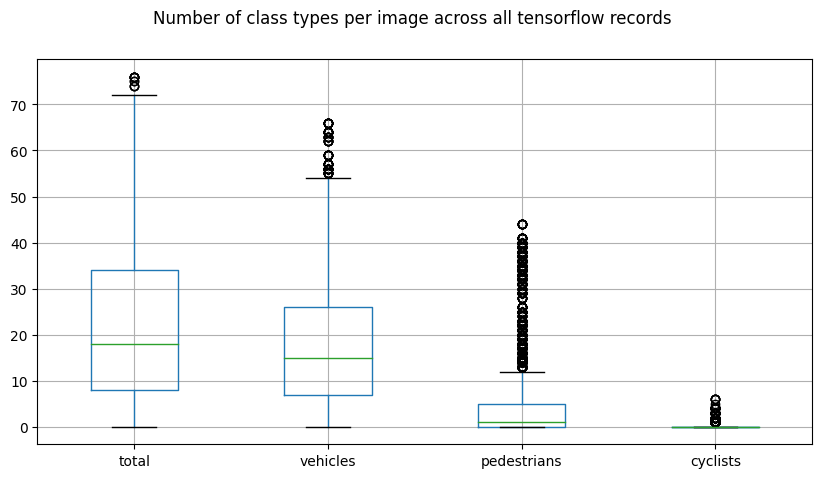

In [118]:
fig, axes = plt.subplots(1, 1, figsize=(10, 5))
plt.suptitle('Number of class types per image across all tensorflow records')
box = countsDF.boxplot(ax=axes)

print(f"Median nr of vehicles in image: {countsDF['vehicles'].median():.1f}")
print(f"Median nr of pedestrians in image: {countsDF['pedestrians'].median():.1f}")
print(f"Median nr of cyclists in image: {countsDF['cyclists'].median():.1f}")

#### Bounding box statistics

In [95]:
# Populate dataframe with information and print first few rows
bboxesDF = pd.DataFrame(list(zip(boxFile, boxImage, boxClass, boxCoor, boxArea, 
                                 boxCenterQuadrant)),
                        columns=['file', 'image number', 'class', 
                                 'coordinates (y1, x1, y2, x2)', 
                                 'area [%]', 'quadrant'])
bboxesDF.index.name = 'box nr'
bboxesDF['class'].replace(1, 'vehicle', inplace=True)
bboxesDF['class'].replace(2, 'pedestrian', inplace=True)
bboxesDF['class'].replace(4, 'cyclist', inplace=True)
print(tabulate(bboxesDF.head(15), headers='keys', tablefmt='psql', floatfmt='.2f'))

+----------+------------------------------------------------+----------------+---------+--------------------------------+------------+--------------+
|   box nr | file                                           |   image number | class   | coordinates (y1, x1, y2, x2)   |   area [%] | quadrant     |
|----------+------------------------------------------------+----------------+---------+--------------------------------+------------+--------------|
|        0 | segment-10017090168044687777_6380_000_6400_000 |              0 | vehicle | [0.58, 0.7, 0.62, 0.73]        |       0.10 | bottom right |
|        1 | segment-10017090168044687777_6380_000_6400_000 |              0 | vehicle | [0.55, 0.7, 0.56, 0.72]        |       0.01 | bottom right |
|        2 | segment-10017090168044687777_6380_000_6400_000 |              0 | vehicle | [0.62, 0.72, 0.64, 0.73]       |       0.02 | bottom right |
|        3 | segment-10017090168044687777_6380_000_6400_000 |              0 | vehicle | [0.51, 0.78

Percentage of bounding boxes grouped by class and center location: 
class       quadrant    
cyclist     bottom left      0.241450
            bottom right     0.157649
            top left         0.107369
            top right        0.065993
pedestrian  bottom right     9.088671
            bottom left      7.654638
            top left         2.881684
            top right        2.173048
vehicle     bottom left     35.573770
            bottom right    23.244645
            top left        12.783743
            top right        6.027340
Name: quadrant, dtype: float64


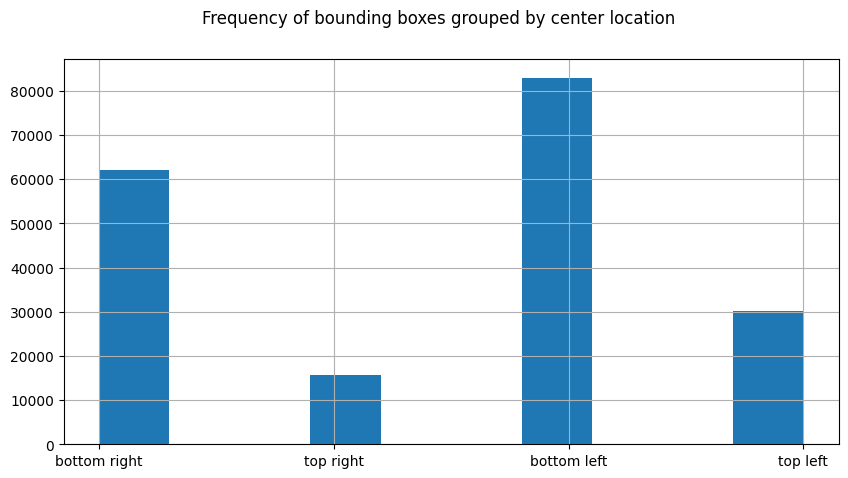

In [115]:
fig, axes = plt.subplots(1, 1, figsize=(10, 5))
plt.suptitle('Frequency of bounding boxes grouped by center location')
box = bboxesDF['quadrant'].hist(ax=axes)

print(f"Percentage of bounding boxes grouped by class and center location: \n" 
      f"{100 * bboxesDF.groupby('class')['quadrant'].value_counts() / bboxesDF.shape[0]}")

### Image statistic

In [119]:
def calculate_mean_std(image_list):
    """
    calculate mean and std of image list
    args:
    - image_list [list[str]]: list of image paths
    returns:
    - mean [array]: 1x3 array of float, channel wise mean
    - std [array]: 1x3 array of float, channel wise std
    """
    means = []
    stds = []
    for path in image_list:
        img = Image.open(path).convert('RGB')
        stat = ImageStat.Stat(img)
        means.append(np.array(stat.mean))
        stds.append(np.array(stat.var)**0.5)
    total_mean = np.mean(means, axis=0)
    total_std = np.mean(stds, axis=0)
    
    return total_mean, total_std

In [129]:
image = tf.cast(batch['image']/255, tf.float32)

<class 'tensorflow.python.framework.ops.EagerTensor'>


## Exploratory Data Analysis
1. Uniformity across images in a single file appears to be high. E.g. all images in a single file are in sunny conditions / rainy conditions / daytime / nighttime. 
2. Number of annotated objects varies a lot between the different files. 
3. The vast majority of objects are classified as "vehicle". Especially the percentage of objects classified as "cyclist" is very low.

Rather than use sets of files for training or validation or testing pruposes, content for each of those purposes should be randomly selected from each of the files. This should ensure increased uniformity across the data that is used for training, validation and testing purposes.